In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler 
from sklearn.decomposition import PCA
from scipy.spatial.distance import pdist, squareform
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier 
from sklearn.metrics import accuracy_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist

In [5]:
from scipy.spatial.distance import pdist, squareform
def VAT(R):
    R = np.array(R)
    N, M = R.shape
    if N != M:
        R = squareform(pdist(R))
    J = list(range(0, N))
    
    y = np.max(R, axis=0)
    i = np.argmax(R, axis=0)
    j = np.argmax(y)
    y = np.max(y)
    
    I = i[j]
    del J[I]
    
    y = np.min(R[I,J], axis=0)
    j = np.argmin(R[I,J], axis=0)
    I = [I, J[j]]
    J = [e for e in J if e != J[j]]
    C = [1,1]

    for r in range(2, N-1):
        y = np.min(R[I,:][:,J], axis=0)
        i = np.argmin(R[I,:][:,J], axis=0)
        j = np.argmin(y)
        y = np.min(y)
        I.extend([J[j]])
        J = [e for e in J if e != J[j]]
        C.extend([i[j]])

    y = np.min(R[I,:][:,J], axis=0)
    i = np.argmin(R[I,:][:,J], axis=0)

    I.extend(J)
    C.extend(i)

    RI = list(range(N))
    for idx, val in enumerate(I):
        RI[val] = idx

    RV = R[I,:][:,I]
    return RV.tolist(), C, I


def entropy(probs):
    
    return -probs.dot(np.log2(probs))


def mutual_info(df):
    
    Hx = entropy(df.iloc[:,0].value_counts(normalize=True, sort=False))
    Hy = entropy(df.iloc[:,1].value_counts(normalize=True, sort=False))
    
    counts = df.groupby(list(df.columns.values)).size()
    probs = counts/ counts.values.sum()
    H_xy = entropy(probs)

    # Mutual Information
    I_xy = Hx + Hy - H_xy
    MI = I_xy
    NMI = I_xy/min(Hx,Hy) #I_xy/np.sqrt(H_x*H_y)
    
    return {'H_'+list(df)[0]:Hx,'H_'+list(df)[1]:Hy,'MI':MI,'NMI':NMI} 




In [7]:
food =  pd.read_csv("food_nutrient_2011_13_AHS.csv", header=0,low_memory=False)

In [8]:
new_df = food.iloc[:, 4:]

In [9]:
att = new_df.columns.values

In [10]:
print("Foodscaled Matrix Details:")
new_df.describe()

Foodscaled Matrix Details:


,"Energy, with dietary fibre (kJ)","Energy, without dietary fibre (kJ)",Moisture (g),Protein (g),Total fat (g),"Available carbohydrates, with sugar alcohols (g)","Available carbohydrates, without sugar alcohol (g)",Starch (g),Total sugars (g),Added sugars (g),...,Total saturated fat (g),Total monounsaturated fat (g),Total polyunsaturated fat (g),Linoleic acid (g),Alpha-linolenic acid (g),C20:5w3 Eicosapentaenoic (mg),C22:5w3 Docosapentaenoic (mg),C22:6w3 Docosahexaenoic (mg),Total long chain omega 3 fatty acids (mg),Total trans fatty acids (mg)
count,5740.000000,5740.000000,5740.000000,5740.000000,5740.000000,5740.000000,5740.000000,5740.000000,5740.000000,5740.000000,...,5740.000000,5740.000000,5740.000000,5740.000000,5740.000000,5740.000000,5740.000000,5740.000000,5740.000000,5740.000000
mean,880.160801,862.882056,56.282892,10.422544,10.109983,18.395662,18.290819,10.289477,7.752578,5.033136,...,3.653233,3.911237,1.711493,1.401394,0.215767,15.645183,13.136369,20.638564,49.420135,211.312470
std,645.450232,640.789714,27.793140,9.879095,14.657683,22.194143,22.128313,15.988358,13.753988,12.417881,...,6.068300,6.471672,4.256266,3.787727,0.984584,79.793671,37.567347,100.881199,202.029963,503.503916
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,386.000000,371.000000,38.100000,2.600000,1.400000,1.000000,0.900000,0.000000,0.200000,0.000000,...,0.290000,0.310000,0.150000,0.080000,0.010000,0.000000,0.000000,0.000000,0.000000,1.890000
50%,742.000000,734.000000,62.700000,7.000000,5.600000,9.550000,9.400000,1.300000,2.100000,0.000000,...,1.500000,2.085000,0.770000,0.540000,0.070000,0.000000,0.205000,0.000000,0.913500,54.365000
75%,1229.000000,1196.250000,77.400000,16.300000,12.500000,26.825000,26.800000,15.125000,8.200000,2.200000,...,4.362500,4.670000,1.540000,1.220000,0.180000,4.150000,11.400000,5.760000,27.689500,202.722500
max,3703.000000,3703.000000,100.000000,98.000000,100.000000,100.000000,100.000000,88.400000,100.000000,100.000000,...,92.410000,80.590000,72.560000,72.270000,54.590000,1757.840000,614.520000,1700.170000,3420.828000,9712.960000


In [11]:
scaler = StandardScaler()
scaler.fit(new_df)
foodscaled = scaler.transform(new_df)
dataset = pd.DataFrame(foodscaled, columns = att)

In [12]:
food['Energylevels'] = np.where(food['Energy, without dietary fibre (kJ)']>1000, 1, 0)
dataset['EnergyLevel'] = food['Energylevels']

In [13]:
eg_high = dataset.loc[dataset['EnergyLevel'] == 1, :]    #assigning high and low energy levels
eg_low = dataset.loc[dataset['EnergyLevel'] == 0, :]

In [14]:
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(dataset)
principalDf = pd.DataFrame(data=principalComponents, columns = ['principal component 1', 'principal component 2'])

Text(0.5,1,'K means clusters')

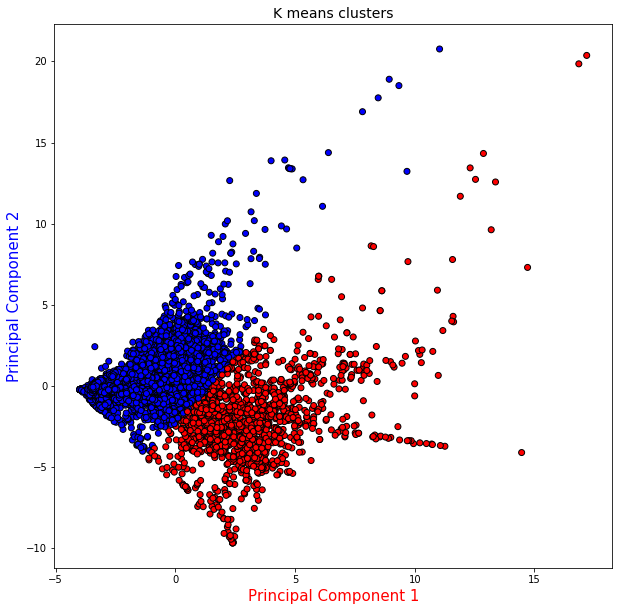

In [15]:
km = KMeans(n_clusters = 2)
km.fit(principalDf)
km.predict(principalDf)
labels = km.labels_
fig = plt.figure(1, figsize=(10,10))
ax = plt.axis(rect = [0, 0, 1, 1])
color_map = {0: "b", 1:"r"}
plt.scatter(principalDf.iloc[:,0], principalDf.iloc[:,1],c=[color_map[label] for label in labels], edgecolor="k")
plt.xlabel("Principal Component 1", fontsize = 15, color='red')
plt.ylabel("Principal Component 2", fontsize = 15, color='blue')
plt.title("K means clusters", fontsize = 14)

In [16]:
food["food category"] = food['Survey ID'].astype(str).map(lambda x: x[:2]).astype(int)
sample = [13, 20, 24]
indices = food['food category'].map(lambda x: x in sample)
foodscaledsample = foodscaled[indices]
foodscaledsample

array([[ 1.33691852,  1.26123802, -1.95327414, ..., -0.20460069,
        -0.24463916, -0.41972043],
       [ 1.13239229,  1.04273857, -1.93528252, ..., -0.20460069,
        -0.24463916, -0.41972043],
       [ 1.24395205,  1.22534168, -1.88130767, ..., -0.20460069,
        -0.24463916, -0.39389912],
       ...,
       [-0.82610126, -0.82387097,  1.0657194 , ..., -0.20460069,
        -0.24253533, -0.31707078],
       [-1.24445036, -1.24370205,  1.34998697, ..., -0.20460069,
        -0.24463916, -0.41972043],
       [-0.90977108, -0.90502791,  1.14848085, ..., -0.20460069,
        -0.24463916, -0.36837574]])

In [17]:
VAT(foodscaledsample)

([[0.0,
   32.91490219137666,
   36.87639536233601,
   37.19805472993243,
   37.65760761512536,
   37.709233139449154,
   37.8302188123534,
   37.73759205024295,
   37.779594250848156,
   37.78364178863395,
   37.845536508203956,
   37.973905340639305,
   37.6611803077119,
   37.721727854892826,
   37.69537773770473,
   37.75782221384141,
   37.682229533661754,
   37.71946604217799,
   37.7356295855645,
   37.72313919120042,
   37.70413976829919,
   37.76541025065146,
   37.73020572005879,
   37.77497853039391,
   37.790549716327334,
   37.66334568889317,
   37.65968717726579,
   37.71550488675532,
   37.5647158509982,
   37.48420743727275,
   37.577509450674306,
   37.549566203278914,
   37.58379017247257,
   37.555673720880776,
   37.66606943748688,
   37.450986572722385,
   37.41690555162746,
   37.45525228334245,
   37.45528076871913,
   37.45562548022293,
   37.6557045074822,
   37.62819479491445,
   37.68067566646393,
   37.45847665334562,
   37.73005324095459,
   37.744472314724

In [ ]:
RV, C, I = VAT(foodscaledsample)
x= sns.heatmap(RV,cmap='magma',xticklabels=False,yticklabels=False)
x.set(xlabel='objects', ylabel='objects')
plt.show()

In [ ]:
x = food.iloc[:10, 4:14]
x

In [ ]:
x.corr()

In [ ]:
colormap = plt.cm.viridis
plt.figure(figsize=(12,12))
plt.title('Pearson Correlation of Features', y=1.05, size=15)
sns.heatmap(x.astype(float).corr(),linewidths=0.1,vmax=1.0, square=True, cmap=colormap, linecolor='white', annot=True)

In [ ]:
sns.heatmap(x.corr())

In [ ]:
def get_redundant_pairs(x):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = x.columns
    for i in range(0, x.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop


def get_top_abs_correlations(x, n=10):
    au_corr = x.corr().abs().unstack()
    labels_to_drop = get_redundant_pairs(x)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=False)
    return au_corr[0:n]

print("Top Absolute Correlations:"
     )
print(get_top_abs_correlations(x, 10))

In [ ]:
cols = food.drop(["Food ID","Food Name", "Survey flag", "Survey ID", "Energylevels", "food category" ], axis =1).columns.values
pairs = []
for i in range(cols.size):
    for j in range(i+1, cols.size):
        pairs.append([cols[i],cols[j]])

MI_s = [calc_MI(feature_set, 20) for feature_set in pairs ]

indices = np.argsort(MI_s)[::-1][:10]
for i in list(indices):
    print("{}: {}".format(pairs[i], MI_s[i]))

In [ ]:
data = dataset

sse = {}
for k in range(2, 25):
    kmeans = KMeans(n_clusters=k, random_state=100).fit(data)
    data["clusters"] = kmeans.labels_
  
    sse[k] = kmeans.inertia_ # Inertia: Sum of distances of samples to their closest cluster center
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.ylabel("SSE")
plt.show()

In [ ]:
from sklearn.metrics import mutual_info_score

def calc_MI(features, bins):
    c_xy = np.histogram2d(food[features[0]], food[features[1]], bins)[0]
    mi = mutual_info_score(None, None, contingency=c_xy)
    return mi
features = ['Protein (g)', 'Energy, with dietary fibre (kJ)' ]
bins = [2] + list(range(10, 210, 10))
MI = [calc_MI(features, bin) for bin in bins]
fig = plt.figure(1, figsize=(10,10))
ax = plt.axis(rect = [0, 0, 1, 1])
plt.plot(bins, MI,c="r")
plt.xlabel("number of bins", fontsize = 15)
plt.ylabel("MI of features", fontsize = 15)
plt.title("Mutual Information", fontsize = 14)

In [ ]:
df_1 = pd.DataFrame({"Number of Bins": bins, "Mutual Information": MI})
print(df.to_string(index=False))

In [ ]:
food["food category"] = food['Survey ID'].astype(str).map(lambda x: x[:2]).astype(int)
sample = [13, 20, 24]
indices = food['food category'].map(lambda x: x in sample)
foodscaledsamples = new_df[indices]

In [ ]:
# create training and testing vars
mass = foodscaledsamples['food category']
X_train, X_test, y_train, y_test = train_test_split(foodscaledsamples, mass, test_size=0.2)
print('Train Test Split Results:')
print('x-train matrix:')
print(X_train.shape)
print('y-train labels')
print(y_train.shape)
print('x-test matrix:')
print(X_test.shape)
print('y-test labels')
print(y_test.shape)

In [ ]:
from sklearn import tree
from sklearn.model_selection import KFold

accuracies = []
depth_range = range(1, 41)

for depth in depth_range:
    
    tree_model = tree.DecisionTreeClassifier(max_depth = depth)
    

    model = tree_model.fit(X_train, y_train) 
                              
    valid_acc = model.score(X_test, y_test)
        
    
    accuracies.append(valid_acc)
   

df = pd.DataFrame({"Max Depth": depth_range, "Average Accuracy": accuracies})
df = df[["Max Depth", "Average Accuracy"]]
print(df.to_string(index=False))
plt.plot(df['Max Depth'], df['Average Accuracy'])
plt.xlabel("Max Depth")
plt.ylabel("Average Accuracy")
plt.show()